<a href="https://colab.research.google.com/github/bongbong31/DL/blob/main/deeplearning_main_q_ny.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import warnings
warnings.filterwarnings('ignore')

In [3]:
import tensorflow as tf

In [4]:
import tensorflow_datasets as tfds

tfds.__version__

'4.9.6'

# 데이터 로드

In [5]:
# 데이터셋 로드
dataset, info = tfds.load('tf_flowers', with_info=True, as_supervised=True)

Dl Completed...:   0%|          | 0/5 [00:00<?, ? file/s]

Dataset tf_flowers downloaded and prepared to /root/tensorflow_datasets/tf_flowers/3.0.1. Subsequent calls will reuse this data.


In [6]:
(train, validation, test), metadata = tfds.load(
    name='tf_flowers',
    split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'],
    with_info=True,
    as_supervised=True,
)

In [7]:
# 각 데이터 크기 확인
print(train)
print(validation)
print(test)

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_PrefetchDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>


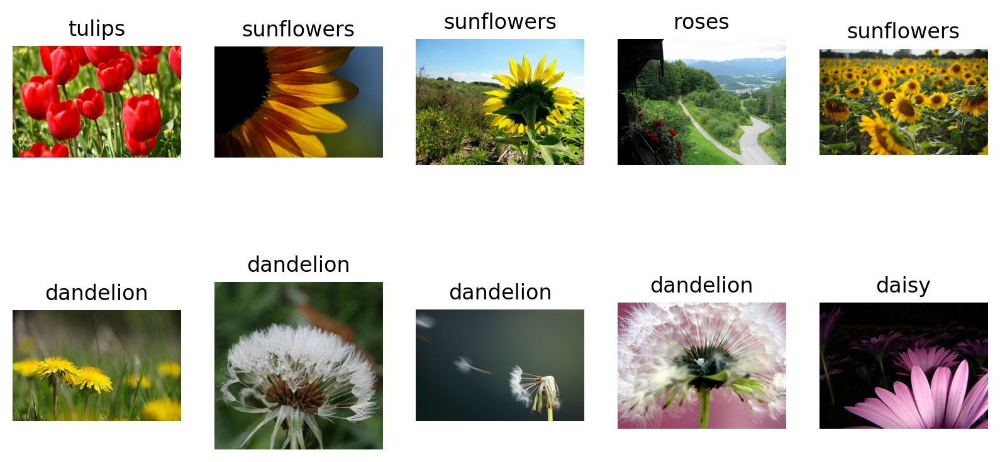

In [8]:
# 데이터 확인
plt.figure(figsize=(10,5))

get_label_name = metadata.features['label'].int2str

# 데이터 10개 가져오기
for i, (image, label) in enumerate(train.take(10)):
    plt.subplot(2,5,i+1)
    plt.imshow(image)
    plt.title(get_label_name(label))
    plt.axis('off')

# 이미지 사이즈 통일

In [9]:
# 이미지 사이즈 통일 시켜주기
IMG_SIZE = 160

def format_example(image, label):
    image = tf.cast(image, tf.float32)
    image = (image/127.5) -1
    image = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))
    return image, label

In [10]:
train = train.map(format_example)
validation = validation.map(format_example)
test = test.map(format_example)

In [11]:
# 각 데이터 확인
print(train)
print(validation)
print(test)

<_MapDataset element_spec=(TensorSpec(shape=(160, 160, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(160, 160, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
<_MapDataset element_spec=(TensorSpec(shape=(160, 160, 3), dtype=tf.float32, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>


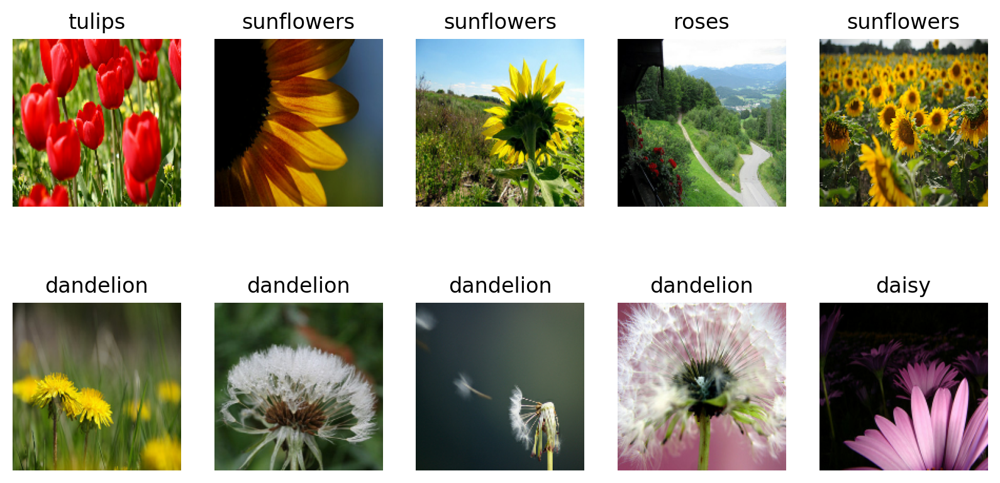

In [12]:
# 데이터 확인
plt.figure(figsize=(10,5))

get_label_name = metadata.features['label'].int2str

# 데이터 10개 가져오기
for i, (image, label) in enumerate(train.take(10)):
    plt.subplot(2,5,i+1)
    image = (image +1)/2
    plt.imshow(image)
    plt.title(get_label_name(label))
    plt.axis('off')

-> (160, 160, 3)으로 이미지 사이즈 통일

# 모델 설계

In [13]:
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D, BatchNormalization
from tensorflow.keras.optimizers import Adam

In [14]:
model = Sequential([
    Conv2D(filters=16, kernel_size=(3,3), padding='same', activation='relu',
           input_shape=(160,160,3)),
    # BatchNormalization(),
    MaxPooling2D(),
    # Dropout(0.2),

    Conv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu'),
    # BatchNormalization(),
    MaxPooling2D(),
    # Dropout(0.2),

    Conv2D(filters=64, kernel_size=(3,3), padding='same', activation='relu'),
    MaxPooling2D(),

    Flatten(),
    Dense(units=512, activation='relu'),
    Dense(units=5, activation='softmax')
])

In [15]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 160, 160, 16)        │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 80, 80, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 80, 80, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 40, 40, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 40, 40, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 20, 20, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25600)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 512)                 │      13,107,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 5)                   │           2,565 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 13,133,861 (50.10 MB)

 Trainable params: 13,133,861 (50.10 MB)

 Non-trainable params: 0 (0.00 B)

# 모델 학습

In [19]:
learning_rate = 0.001
model.compile(optimizer=Adam(learning_rate),
              loss = tf.keras.losses.SparseCategoricalCrossentropy,
              metrics=['accuracy']
              )

LMS에서는 optimizer에 RMSprop 사용함 \
adam vs rmsprop \
나중에 rmsprop도 사용해보기

In [20]:
batch_size = 32
shuffle_buffer_size = 1000

In [21]:
train_batch = train.shuffle(shuffle_buffer_size).batch(batch_size)
validation_batch = validation.batch(batch_size)
test_batch = test.batch(batch_size)

In [22]:
# 초기 모델 성능
validation_steps = 20
loss0, accuracy0 = model.evaluate(validation_batch, steps = validation_steps)

print('initial loss : {:.2f}'.format(loss0))
print('initial accuracy : {:.2f}'.format(accuracy0))

20/20 ━━━━━━━━━━━━━━━━━━━━ 4s 56ms/step - accuracy: 0.1422 - loss: 1.6624
initial loss : 1.65
initial accuracy : 0.16


초기 모델 \
loss : 1.65 \
accuracy : 0.16

In [23]:
epochs = 10
history = model.fit(train_batch,
                    epochs=epochs,
                    validation_data = validation_batch)

Epoch 1/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 20s 148ms/step - accuracy: 0.3525 - loss: 1.9781 - val_accuracy: 0.5777 - val_loss: 1.0167
Epoch 2/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - accuracy: 0.5765 - loss: 1.0397 - val_accuracy: 0.6485 - val_loss: 0.9513
Epoch 3/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - accuracy: 0.6941 - loss: 0.8210 - val_accuracy: 0.6540 - val_loss: 0.8657
Epoch 4/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - accuracy: 0.7761 - loss: 0.6092 - val_accuracy: 0.6485 - val_loss: 0.9387
Epoch 5/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 23ms/step - accuracy: 0.8567 - loss: 0.4132 - val_accuracy: 0.6485 - val_loss: 1.0623
Epoch 6/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 24ms/step - accuracy: 0.9426 - loss: 0.1958 - val_accuracy: 0.6594 - val_loss: 1.1541
Epoch 7/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 21ms/step - accuracy: 0.9689 - loss: 0.1160 - val_accuracy: 0.6431 - val_loss: 1.1981
Epoch 8/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - accuracy: 0.9789 - loss: 0.0684 - val_accuracy: 0.6839 -

학습 1 모델 \
loss : 0.0544 \
accuracy : 0.9836 \

val loss : 1.6908 \
val accuracy : 0.6621 \

음...괜찮은건가?

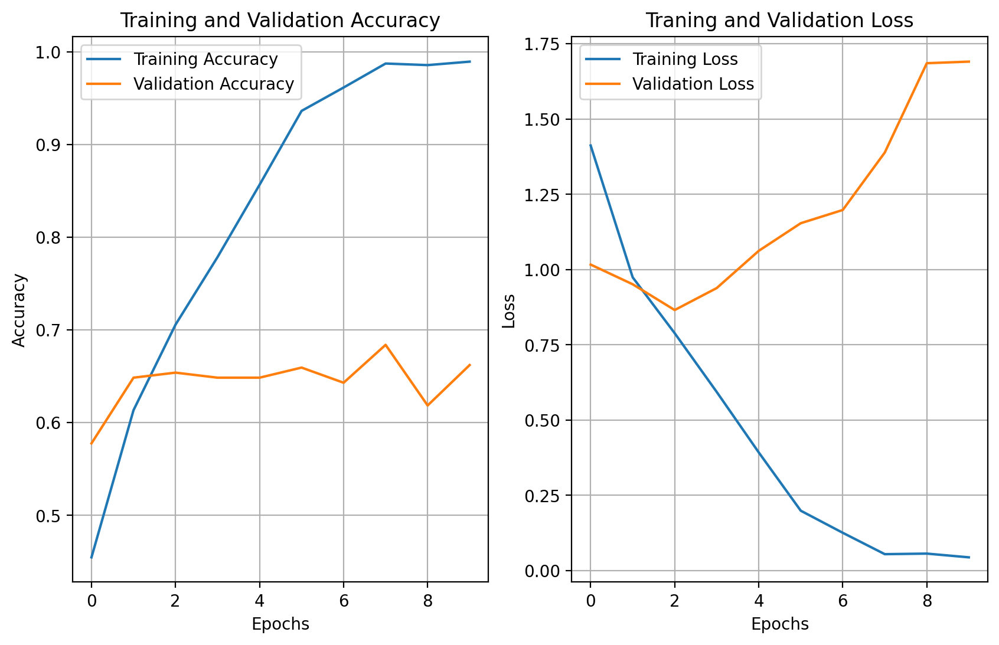

In [24]:
# 결과 시각화

acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.figure(figsize=(10,6))

plt.subplot(1,2,1)
plt.plot(epochs, acc, label='Training Accuracy')
plt.plot(epochs, val_acc, label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()

plt.subplot(1,2,2)
plt.plot(epochs, loss, label='Training Loss')
plt.plot(epochs, val_loss, label='Validation Loss')
plt.title('Traning and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()

plt.show()

overfitting ㅋㅋ

In [25]:
# 모델 예측 결과
for image_batch, label_batch in test_batch.take(1):
    images = image_batch
    labels = label_batch
    predictions = model.predict(image_batch)
    break

predictions

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


array([[1.21584171e-05, 4.60393039e-06, 7.15107322e-01, 3.85769199e-05,
        2.84837276e-01],
       [9.99999285e-01, 7.30174236e-07, 5.99456929e-09, 5.08815483e-13,
        1.39840095e-09],
       [8.37537050e-01, 6.37880148e-05, 1.38558835e-01, 1.88225508e-02,
        5.01777045e-03],
       [4.82850330e-04, 3.39091779e-03, 8.92524362e-01, 2.59500684e-05,
        1.03575841e-01],
       [7.92092919e-01, 5.87792285e-02, 1.36554008e-03, 1.85452045e-05,
        1.47743702e-01],
       [9.19298530e-01, 7.12946728e-02, 3.03370389e-03, 5.23394265e-04,
        5.84967248e-03],
       [2.35374443e-07, 3.71694045e-06, 9.99649644e-01, 7.83838061e-09,
        3.46469198e-04],
       [9.60408390e-01, 1.90181863e-02, 1.49811935e-02, 1.05964527e-05,
        5.58154518e-03],
       [4.53856832e-04, 1.71777834e-13, 8.23717414e-08, 9.99545991e-01,
        3.84168324e-08],
       [9.99999881e-01, 1.75855831e-07, 4.21238644e-09, 1.59729684e-12,
        1.08277227e-08],
       [1.00000000e+00, 4.2697

In [26]:
predictions = np.argmax(predictions, axis=1)
predictions

array([2, 0, 0, 2, 0, 0, 2, 0, 3, 0, 0, 0, 3, 2, 2, 3, 2, 0, 0, 2, 2, 0,
       2, 0, 2, 2, 2, 4, 2, 3, 0, 0])

accuracy : 65.625000%


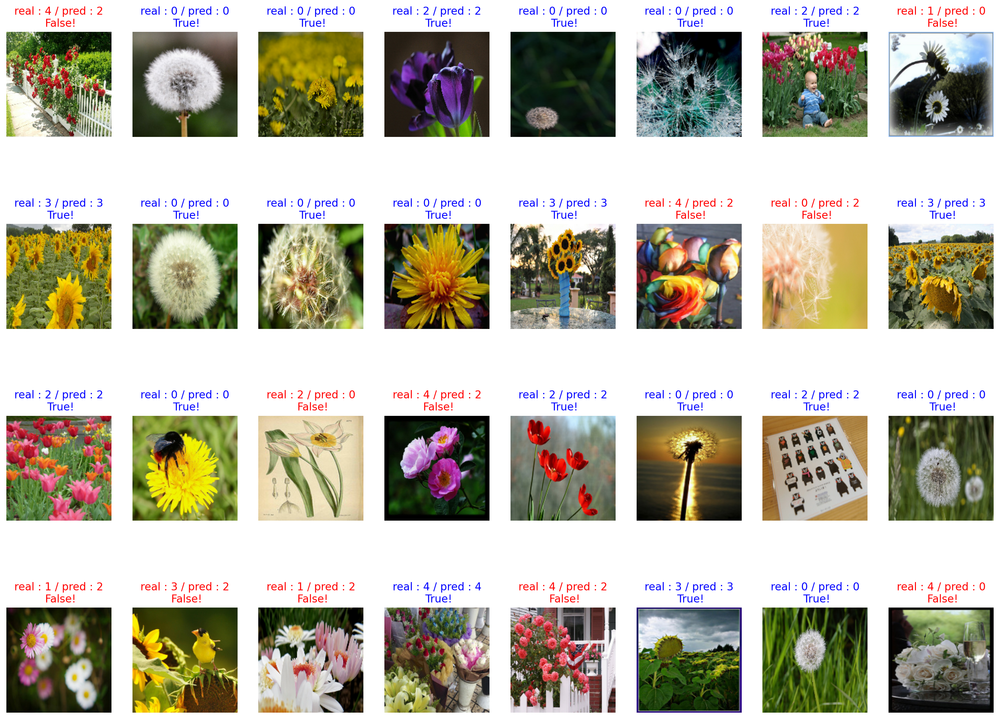

In [27]:
# 시각화
plt.figure(figsize=(20,15))

# 예측 정확도 확인
count = 0

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4,8,idx+1)
    image = (image +1)/2
    plt.imshow(image)
    correct = label == prediction
    title = f'real : {label} / pred : {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
        count += 1

    plt.axis('off')

total = len(images)
print(f'accuracy : {count/total * 100 :2f}%')


# 모델에 batch normailzation이랑 dropout 적용 후 학습 및 예측

In [28]:
model1 = Sequential([
    Conv2D(filters=16, kernel_size=(3,3), padding='same', activation='relu',
           input_shape=(160,160,3)),
    BatchNormalization(),
    MaxPooling2D(),
    Dropout(0.2),

    Conv2D(filters=32, kernel_size=(3,3), padding='same', activation='relu'),
    BatchNormalization(),
    MaxPooling2D(),
    Dropout(0.2),

    Conv2D(filters=64, kernel_size=(3,3), padding='same', activation='relu'),
    MaxPooling2D(),

    Flatten(),
    Dense(units=512, activation='relu'),
    Dense(units=5, activation='softmax')
])

In [29]:
model1.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_3 (Conv2D)                    │ (None, 160, 160, 16)        │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 160, 160, 16)        │              64 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 80, 80, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 80, 80, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 80, 80, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 80, 80, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 40, 40, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 40, 40, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 40, 40, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 20, 20, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 25600)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 512)                 │      13,107,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 5)                   │           2,565 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 13,134,053 (50.10 MB)

 Trainable params: 13,133,957 (50.10 MB)

 Non-trainable params: 96 (384.00 B)

In [30]:
learning_rate = 0.001
model1.compile(optimizer=Adam(learning_rate),
              loss = tf.keras.losses.SparseCategoricalCrossentropy,
              metrics=['accuracy']
              )

In [31]:
train_batch = train.shuffle(shuffle_buffer_size).batch(batch_size)
validation_batch = validation.batch(batch_size)
test_batch = test.batch(batch_size)

In [32]:
history = model1.fit(train_batch,
                    epochs=10,
                    validation_data = validation_batch)

Epoch 1/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 20s 153ms/step - accuracy: 0.3077 - loss: 19.9827 - val_accuracy: 0.2534 - val_loss: 3.1164
Epoch 2/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 25ms/step - accuracy: 0.5401 - loss: 1.1140 - val_accuracy: 0.3815 - val_loss: 3.6610
Epoch 3/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 25ms/step - accuracy: 0.6437 - loss: 0.9142 - val_accuracy: 0.4332 - val_loss: 2.3470
Epoch 4/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 5s 28ms/step - accuracy: 0.7122 - loss: 0.7732 - val_accuracy: 0.4578 - val_loss: 2.1071
Epoch 5/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 5s 26ms/step - accuracy: 0.7448 - loss: 0.6783 - val_accuracy: 0.6458 - val_loss: 1.0703
Epoch 6/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 3s 23ms/step - accuracy: 0.8192 - loss: 0.5179 - val_accuracy: 0.6213 - val_loss: 1.1678
Epoch 7/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - accuracy: 0.8626 - loss: 0.3989 - val_accuracy: 0.6322 - val_loss: 1.3117
Epoch 8/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 4s 24ms/step - accuracy: 0.8783 - loss: 0.3349 - val_accuracy: 0.5995 

dropout이랑 normalization 하니깐 좀 성능 좋아진듯?

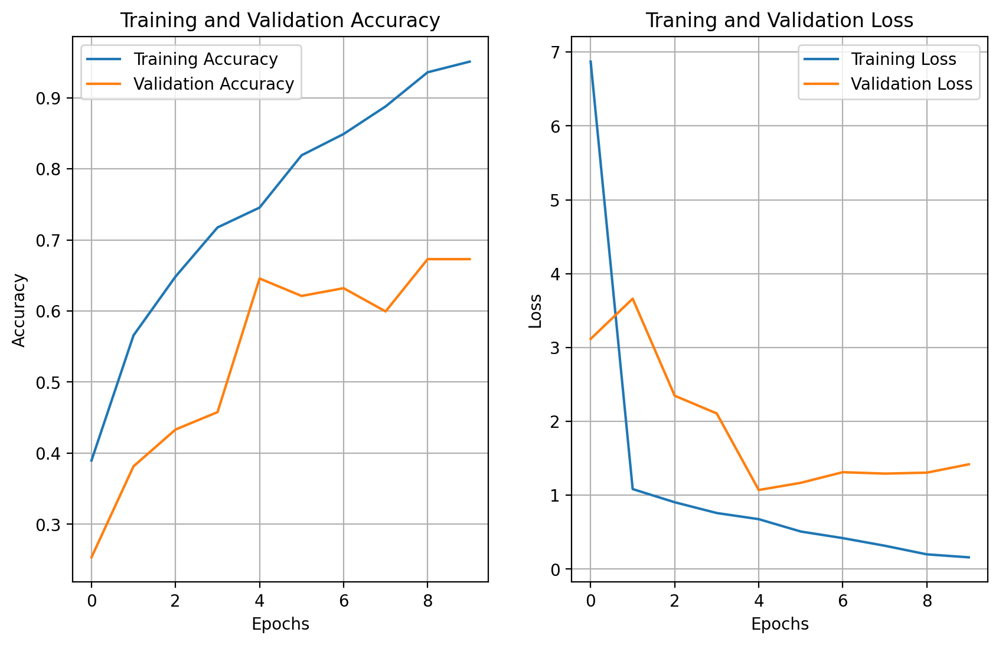

In [33]:
# 시각화
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.figure(figsize=(10,6))

plt.subplot(1,2,1)
plt.plot(epochs, acc, label='Training Accuracy')
plt.plot(epochs, val_acc, label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()

plt.subplot(1,2,2)
plt.plot(epochs, loss, label='Training Loss')
plt.plot(epochs, val_loss, label='Validation Loss')
plt.title('Traning and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()

plt.show()

오! 전보다 val_loss랑 val_accuracy가 괜찮아진듯?

In [34]:
for image_batch, label_batch in test_batch.take(1):
    images = image_batch
    labels = label_batch
    predictions = model1.predict(image_batch)
    break

predictions

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


array([[2.27253367e-05, 5.69018652e-04, 9.47631776e-01, 2.31227893e-02,
        2.86537260e-02],
       [9.20435071e-01, 7.95643553e-02, 7.43573292e-09, 3.54306877e-08,
        5.81706388e-07],
       [5.81560254e-01, 8.78496654e-03, 1.98832495e-05, 4.09634799e-01,
        1.15546854e-07],
       [4.62195389e-02, 3.69316101e-01, 4.90910172e-01, 5.95473731e-03,
        8.75994414e-02],
       [9.95397985e-01, 4.24799882e-03, 5.07641744e-05, 1.23902661e-04,
        1.79331284e-04],
       [1.53355807e-01, 8.12285468e-02, 8.88018832e-02, 2.53868550e-02,
        6.51226878e-01],
       [1.10948327e-04, 8.27905014e-02, 8.64732623e-01, 1.62159849e-03,
        5.07443100e-02],
       [5.07423014e-04, 1.64161250e-01, 1.51563957e-02, 4.43307683e-03,
        8.15741837e-01],
       [1.24748723e-04, 5.29144994e-09, 2.11412861e-08, 9.99875188e-01,
        1.04365225e-10],
       [9.99307871e-01, 6.91947527e-04, 5.53308961e-12, 4.17939248e-08,
        2.28416042e-07],
       [9.93932664e-01, 4.6704

In [35]:
predictions = np.argmax(predictions, axis=1)
predictions

array([2, 0, 0, 2, 0, 4, 2, 4, 3, 0, 0, 3, 3, 2, 0, 3, 2, 0, 1, 4, 2, 0,
       4, 0, 1, 0, 4, 2, 2, 1, 0, 0])

accuracy : 59.38%


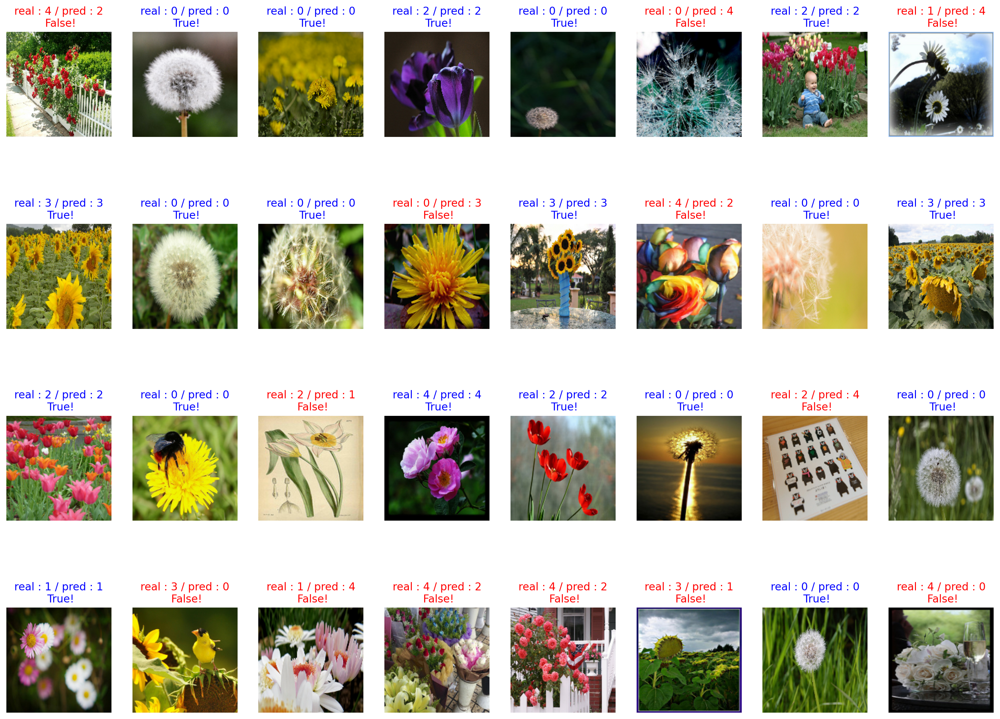

In [36]:
plt.figure(figsize=(20,15))

# 예측 정확도 확인
count = 0

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4,8,idx+1)
    image = (image +1)/2
    plt.imshow(image)
    correct = label == prediction
    title = f'real : {label} / pred : {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
        count += 1

    plt.axis('off')

total = len(images)
print(f'accuracy : {count/total * 100 :.2f}%')

엥...정확도 더 떨어짐;;; 어쩌지

# VGG16 model로 해보기...

In [37]:
# pre-trained 해보기
from tensorflow.keras.applications import VGG16

In [38]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Flatten, Dropout

num_classes = 5

input_shape = (160, 160, 3)
inputs = Input(shape=input_shape)
base_model = VGG16(weights='imagenet', include_top=False, input_shape=input_shape)
x = base_model(inputs)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
outputs = Dense(num_classes, activation='softmax')(x)

model2 = Model(inputs=inputs, outputs=outputs)

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


In [39]:
model2.compile(optimizer=Adam(learning_rate=0.0001),
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

In [40]:
model2.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)           │ (None, 160, 160, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ vgg16 (Functional)                   │ (None, 5, 5, 512)           │      14,714,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 12800)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 256)                 │       3,277,056 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 5)                   │           1,285 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 17,993,029 (68.64 MB)

 Trainable params: 17,993,029 (68.64 MB)

 Non-trainable params: 0 (0.00 B)

In [41]:
history = model2.fit(
    train_batch,
    epochs=10,
    validation_data=validation_batch
)

Epoch 1/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 101s 726ms/step - accuracy: 0.4004 - loss: 1.4575 - val_accuracy: 0.7384 - val_loss: 0.6620
Epoch 2/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 27s 290ms/step - accuracy: 0.7748 - loss: 0.6366 - val_accuracy: 0.8147 - val_loss: 0.4881
Epoch 3/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 41s 289ms/step - accuracy: 0.8627 - loss: 0.3990 - val_accuracy: 0.8556 - val_loss: 0.3794
Epoch 4/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 41s 296ms/step - accuracy: 0.8955 - loss: 0.2987 - val_accuracy: 0.8828 - val_loss: 0.3262
Epoch 5/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 27s 285ms/step - accuracy: 0.9091 - loss: 0.2502 - val_accuracy: 0.8883 - val_loss: 0.3586
Epoch 6/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 41s 287ms/step - accuracy: 0.9341 - loss: 0.2028 - val_accuracy: 0.8774 - val_loss: 0.3204
Epoch 7/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 41s 292ms/step - accuracy: 0.9433 - loss: 0.1640 - val_accuracy: 0.8311 - val_loss: 0.6065
Epoch 8/10
92/92 ━━━━━━━━━━━━━━━━━━━━ 27s 289ms/step - accuracy: 0.9471 - loss: 0.1708 - val_acc

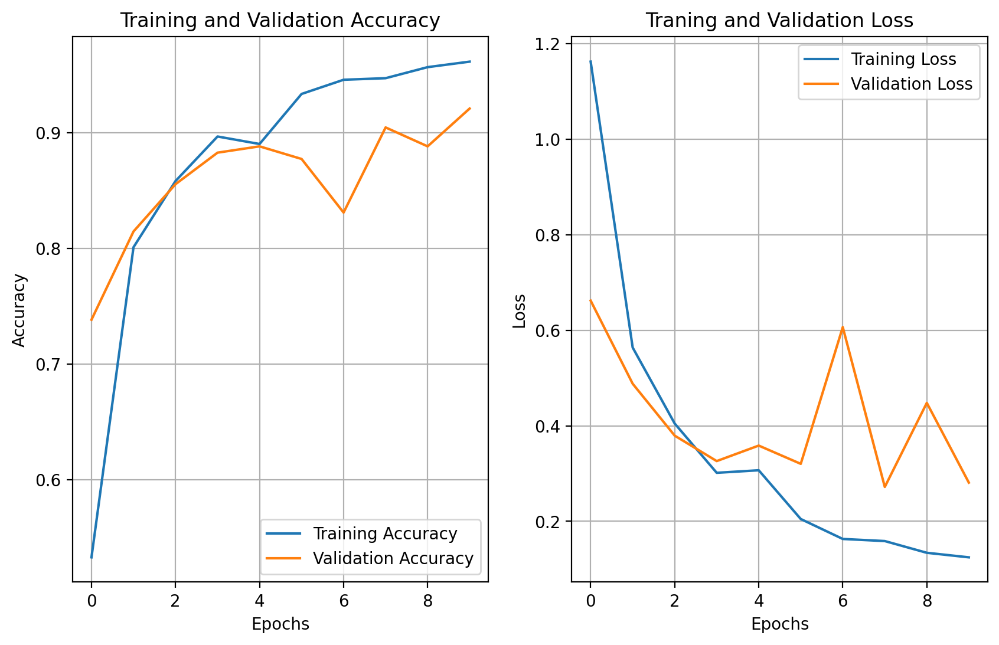

In [42]:
# 시각화
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.figure(figsize=(10,6))

plt.subplot(1,2,1)
plt.plot(epochs, acc, label='Training Accuracy')
plt.plot(epochs, val_acc, label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()

plt.subplot(1,2,2)
plt.plot(epochs, loss, label='Training Loss')
plt.plot(epochs, val_loss, label='Validation Loss')
plt.title('Traning and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()

plt.show()

In [43]:
for image_batch, label_batch in test_batch.take(1):
    images = image_batch
    labels = label_batch
    predictions = model2.predict(image_batch)
    break

predictions

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step


array([[2.34748004e-04, 3.84340849e-04, 9.95283306e-01, 1.13009475e-04,
        3.98459146e-03],
       [1.00000000e+00, 4.85661729e-21, 4.64026519e-29, 1.35378171e-23,
        1.74872457e-24],
       [9.97728527e-01, 2.29171012e-04, 3.41771192e-05, 1.98782049e-03,
        2.03231957e-05],
       [6.03788249e-05, 8.78968043e-04, 9.98517454e-01, 1.82667554e-05,
        5.24874369e-04],
       [9.99969721e-01, 1.73361968e-05, 6.55436509e-07, 1.19349970e-05,
        5.23188817e-07],
       [9.99998689e-01, 5.73977616e-07, 3.71266595e-09, 6.05849891e-07,
        8.04378928e-08],
       [7.14736016e-05, 4.48243809e-04, 9.97115850e-01, 1.83025826e-04,
        2.18144339e-03],
       [3.16016644e-06, 9.99996781e-01, 1.01518082e-11, 2.09381712e-09,
        1.17401144e-10],
       [3.35039260e-07, 1.38716780e-08, 6.95472906e-08, 9.99999523e-01,
        7.30795024e-09],
       [1.00000000e+00, 4.13132081e-17, 1.25456362e-22, 9.18165434e-18,
        1.69841573e-18],
       [1.00000000e+00, 3.6818

In [44]:
predictions = np.argmax(predictions, axis=1)
predictions

array([2, 0, 0, 2, 0, 0, 2, 1, 3, 0, 0, 0, 3, 4, 0, 3, 2, 0, 2, 4, 2, 0,
       4, 0, 1, 2, 1, 2, 2, 3, 0, 4])

accuracy : 84.38%


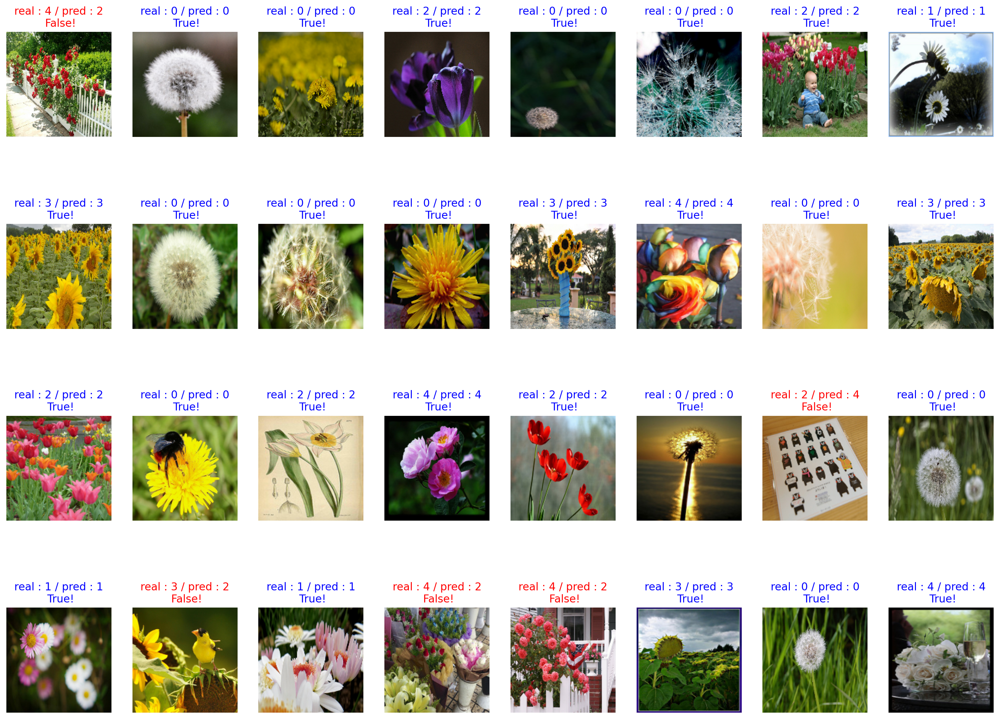

In [45]:
plt.figure(figsize=(20,15))

# 예측 정확도 확인
count = 0

for idx, (image, label, prediction) in enumerate(zip(images, labels, predictions)):
    plt.subplot(4,8,idx+1)
    image = (image +1)/2
    plt.imshow(image)
    correct = label == prediction
    title = f'real : {label} / pred : {prediction}\n {correct}!'
    if not correct:
        plt.title(title, fontdict={'color':'red'})
    else:
        plt.title(title, fontdict={'color': 'blue'})
        count += 1

    plt.axis('off')

total = len(images)
print(f'accuracy : {count/total * 100 :.2f}%')

오 많이 높아짐!

(시간 상 추가는 못했지만...)
이외에도 \

```python
from tensorflow.keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    zoom_range=0.2
)

데이터 증강이라는 방법도 있다함
